[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/JiayueMa/CUS754_SPRING2024_JiayueMa\Problem_set_02/Problem_set_02.ipynb)

This notebook is part the of Dr. Christoforos Christoforou's course materials. You may not, nor may you knowingly allow others to reproduce or distribute lecture notes, course materials or any of their derivatives without the instructor's express written consent.

# Problem Set 02 - Cross Correlation
**Professor:** Dr. Christoforos Christoforou

For this problem set you will need the following libraries, which are pre-installed with the colab environment:

* [Numpy](https://www.numpy.org/) is an array manipulation library, used for linear algebra, Fourier transform, and random number capabilities.
* [Pandas](https://pandas.pydata.org/) is a library for data manipulation and data analysis.
* [CV2](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_gui/py_image_display/py_image_display.html) is a library for computer vision tasks.
* [Skimage](https://scikit-image.org/) is a library which supports image processing applications on python.
* [Matplotlib](https://matplotlib.org/) is a library which generates figures and provides graphical user interface toolkit.

You can load them using the following import statement:

In [61]:
import numpy as np
import pandas as pd
import cv2 as cv
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image
import matplotlib.pylab as plt

## Image Sources
For this problem set you are asked to load and pre-process images. You can choose to use your own images, or download images from the following sources:

**Image source examples**

- [Place Kitten API](https://placekitten.com/) - use the base Place Kitten URL followed by a width and height separated by backslashes ''/''. For example, use the URL `https://placekitten.com/500/300` to fetch a cat image with a width of 500px and height of 300px.

- [Lorem Picsum Photos API ](https://picsum.photos/images) - generates random images from the web.

- [NC State University Libraries Special Collections](https://d.lib.ncsu.edu/collections/catalog) - browse the site to find an image thumbnail. Right-click on the thumbnail and select "Copy Image Address". The address will look like this: `https://iiif.lib.ncsu.edu/iiif/0051230/square/300,/0/default.jpg`. Replace the word "square" with the word "full" and replace "300" with "800" to access the full image at a width of 800px.

- [Google Image search](https://www.google.com/imghp?hl=en) - search for an image. Left-click one of the returned images, then right-click on the full image, and then select "Copy Image Address".


## Example code

The code below illustrates how to use OpenCV to filter images by applying the cross-correlation operator. Try to reproduce the code in the cell below; you can use this sample code as a reference to implement the exercises that follow in this problem set.

```python

# load the input image and convert it to grayscale
# - use the io.imread method from skimage package to read an image from url.
# - use cv form opencv package to change the the image to grayscale.

url = "https://placekitten.com/255/256"
image = io.imread(url)
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)

#
# Define the kernel to use:  
#
kernel_choice = "box"

if kernel_choice == "box":
  # Box filter - size 9
  kernel = np.ones((9,9),np.float32)/81
elif kernel_choice =="gauss":
  # Gaussian filter - kernel size 5, sigma 5
  kernel = cv.getGaussianKernel(ksize=5,sigma=5)

#
# Use cv.filter2D from the openCV package - applies cross-correlation with a given kernel
#

# apply filter to the grayscale imager.
gray_conv = cv.filter2D(gray, -1, kernel)

# apply filter to the colored image.
image_conv = cv.filter2D(image, -1, kernel)

#
# Display the images.
#

plt.figure(figsize=(100,100))
# show the grayscale image.
plt.subplot(2,2,1)
plt.imshow(image)
plt.xticks([]), plt.yticks([]), plt.title('Original Colored')

plt.subplot(2,2,2)
plt.imshow(image_conv)
plt.xticks([]), plt.yticks([]), plt.title('Averaged colored')

# show the grayscale image.
plt.subplot(2,2,3)
plt.imshow(gray, cmap='gray')
plt.xticks([]), plt.yticks([]), plt.title('Original Gratscake')
plt.subplot(2,2,4)
plt.imshow(gray_conv, cmap='gray')
plt.xticks([]), plt.yticks([]), plt.title('Average Grayscale')

```



(([], []), ([], []), Text(0.5, 1.0, 'Average Grayscale'))

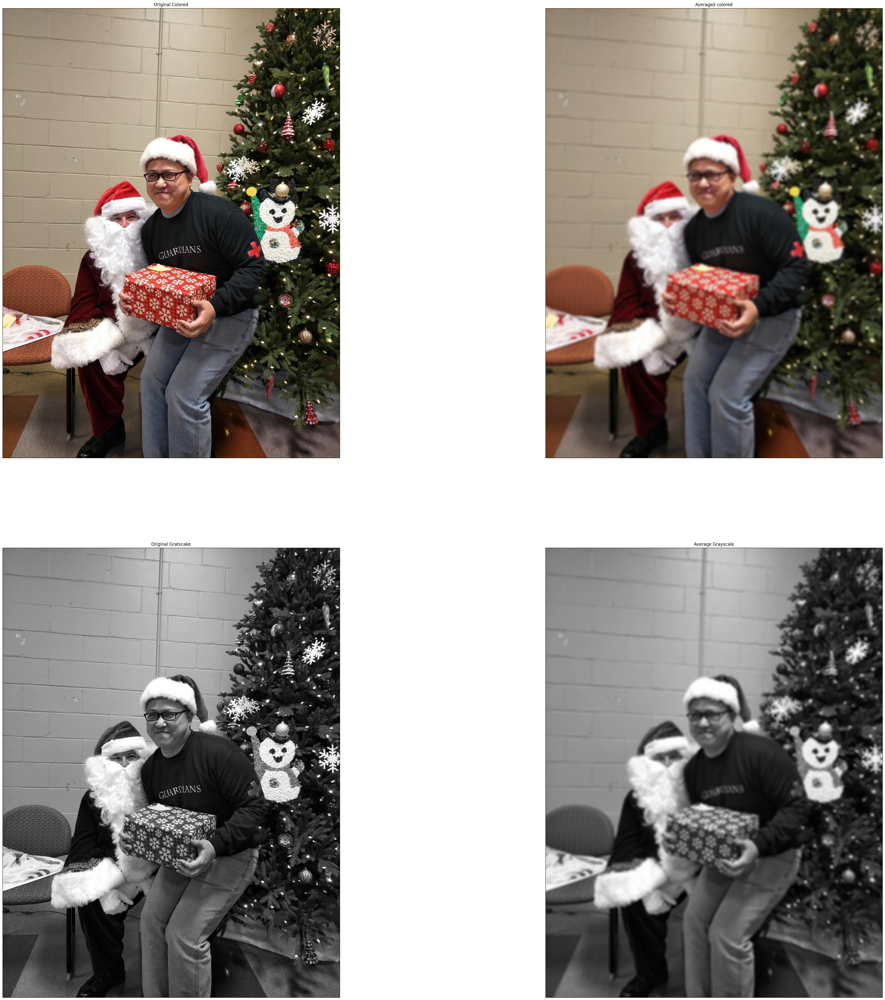

In [60]:
# TODO: Use this cell to reporduce the code above.
# - Try to use different images from the one provided.
# - Try to change the size, and the standard sigma for the kernel.

# load the input image and convert it to grayscale
# - use the io.imread method from skimage package to read an image from url.
# - use cv form opencv package to change the the image to grayscale.

url = "https://media.licdn.com/dms/image/C4D2DAQEMosc8jtR0vw/profile-treasury-image-shrink_1280_1280/0/1618509105583?e=1707307200&v=beta&t=akcVurKLDJx6hAio6TDCYvPzfbYXdEdFVrChHqrgosQ"
image = io.imread(url)
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)

#
# Define the kernel to use:
#
kernel_choice = "box"

if kernel_choice == "box":
  # Box filter - size 9
  kernel = np.ones((9,9),np.float32)/81
elif kernel_choice =="gauss":
  # Gaussian filter - kernel size 5, sigma 5
  kernel = cv.getGaussianKernel(ksize=4,sigma=4)

#
# Use cv.filter2D from the openCV package - applies cross-correlation with a given kernel
#

# apply filter to the grayscale imager.
gray_conv = cv.filter2D(gray, -1, kernel)

# apply filter to the colored image.
image_conv = cv.filter2D(image, -1, kernel)

#
# Display the images.
#

plt.figure(figsize=(50,50))
# show the grayscale image.
plt.subplot(2,2,1)
plt.imshow(image)
plt.xticks([]), plt.yticks([]), plt.title('Original Colored')

plt.subplot(2,2,2)
plt.imshow(image_conv)
plt.xticks([]), plt.yticks([]), plt.title('Averaged colored')

# show the grayscale image.
plt.subplot(2,2,3)
plt.imshow(gray, cmap='gray')
plt.xticks([]), plt.yticks([]), plt.title('Original Gratscake')
plt.subplot(2,2,4)
plt.imshow(gray_conv, cmap='gray')
plt.xticks([]), plt.yticks([]), plt.title('Average Grayscale')


## Exercise 02: Generating Noisy images.

**Task 2.1**. Implement a function called `addGaussianNoise(img,sigma)` that takes as an input argument an image (img) and a noise level `sigma`, and return a noisy version of the image by adding gaussian noise.


**Task 2.2**. Implement a function called `addSaltAndPepperNoise(img,noise_level)` that takes as an input argument an image (img) and a noise level `noise_level`, and return a noisy version of the image by adding salt and pepper noise. The noise_level would be a number between 0..1, which denotes the probability a pixel is converted to a noisy pixel.

**Task 2.3**. Implement a function called `addImpulseNoise(img,noise_level)` that takes as an input argument an image (img) and a noise level `noise_level`, and return a noisy version of the image by adding salt and pepper noise. The noise_level would be a number between 0..1, which denotes the probability a pixel is converted to a noisy pixel.


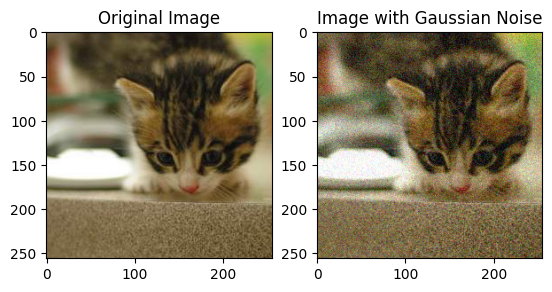

In [30]:
def addGaussianNoise(img, sigma):

    gaussian_noise = np.random.normal(0, sigma, img.shape)


    noisy_img = img + gaussian_noise


    noisy_img_clipped = np.clip(noisy_img, 0, 255)


    return noisy_img_clipped.astype(np.uint8)


url = "https://placekitten.com/255/256"
img = io.imread(url)
#gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
noisy_img = addGaussianNoise(img, 20)

#plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(img)

plt.subplot(1, 2, 2)
plt.title("Image with Gaussian Noise")
plt.imshow(noisy_img)

plt.show()







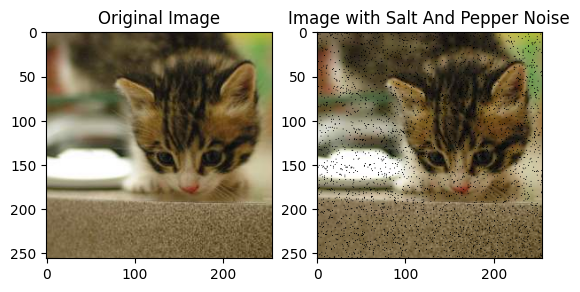

In [29]:
# Implement Task 2.2 here

def addSaltAndPepperNoise(img, noise_level):
    rnd = np.random.rand(img.shape[0], img.shape[1])
    noisy_img = np.copy(img)
    salt = rnd < (noise_level / 2)
    noisy_img[salt] = 255
    pepper = rnd < noise_level
    noisy_img[pepper] = 0

    return noisy_img


url = "https://placekitten.com/255/256"
img = io.imread(url)


noisy_img = addSaltAndPepperNoise(img, 0.05)

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(img)

plt.subplot(1, 2, 2)
plt.title("Image with Salt And Pepper Noise")
plt.imshow(noisy_img)

plt.show()


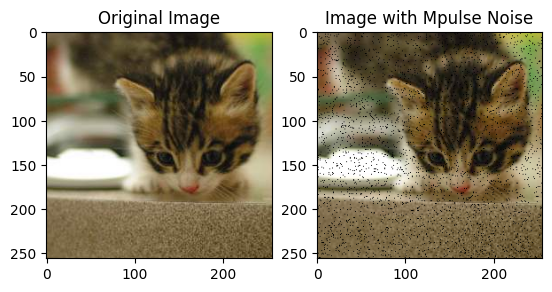

In [31]:
# Implement Task 2.3 here


def addImpulseNoise(img, noise_level):
    rnd = np.random.rand(img.shape[0], img.shape[1])
    noisy_img = np.copy(img)
    noisy_img[rnd < (noise_level / 2)] = 255
    noisy_img[rnd < noise_level] = 0
    return noisy_img


url = "https://placekitten.com/255/256"
img = io.imread(url)


noisy_img = addSaltAndPepperNoise(img, 0.05)

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(img)

plt.subplot(1, 2, 2)
plt.title("Image with Mpulse Noise")
plt.imshow(noisy_img)

plt.show()

## Exercise 3: Apply filtering using OpenCV library.

**Task 3.1** Identify an image from the web, load it in python and generate two noisy versions of the input image, one by adding Gaussian noise and a second by salt and pepper noise. Use the functions you implemented in the previous exercise. Display the resulting images.


**Task 3.2** Compare the effects of denoising using box filter vs a gaussian filter on each image, as you change the level of noise. Try at least 5 different noise levels for each noise type, and keep the kernel size fixed. For each parameter configuration, display the four images in a single row as follows:

  - show the original image, use title "Original"
  - display the noisy image, in title indicate the noise type and noise level.
  - display the filtered images using a gaussian filter.
  - display the filtered image using the box filter.
  

**Task 3.3** Compare the effects of kernel-size and standard-deviation when using a Gaussian filter. Try applying a gaussian filter of kernel sizes 3,5,7,11,and 15 and try different standard deviation Configurations. Use one of the noisy images you generated previously, keep the noise level fixed. For each parameter configuration display the image resulting images in a single row, as follows:
  
  - Display the noisy image, use title "Noisy"
  - display the filtered images using a gaussian filter; in title indicate the kernel size, and standard deviations used.

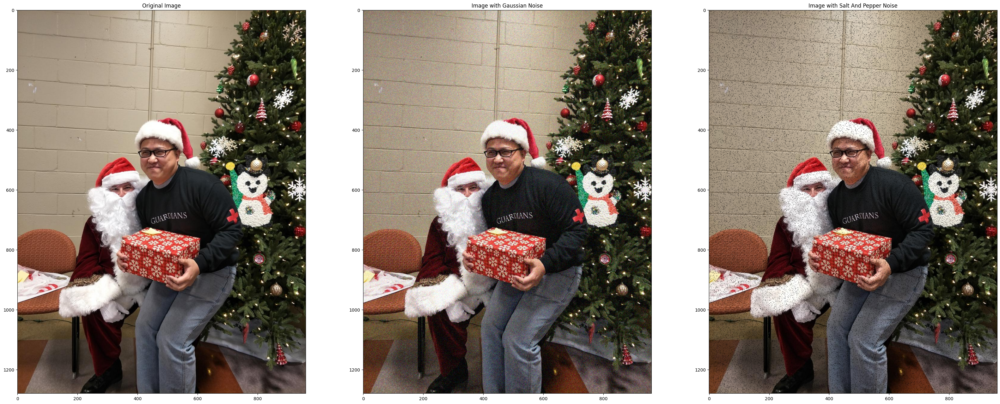

In [32]:
# Implement Task 3.1 here.
url = "https://media.licdn.com/dms/image/C4D2DAQEMosc8jtR0vw/profile-treasury-image-shrink_1280_1280/0/1618509105583?e=1707307200&v=beta&t=akcVurKLDJx6hAio6TDCYvPzfbYXdEdFVrChHqrgosQ"
img = io.imread(url)

noisy_img1 = addGaussianNoise(img, 20)
noisy_img2 = addSaltAndPepperNoise(img, 0.05)

plt.figure(figsize=(40,40))

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img)

plt.subplot(1, 3, 2)
plt.title("Image with Gaussian Noise")
plt.imshow(noisy_img1)

plt.subplot(1, 3, 3)
plt.title("Image with Salt And Pepper Noise")
plt.imshow(noisy_img2)


plt.show()

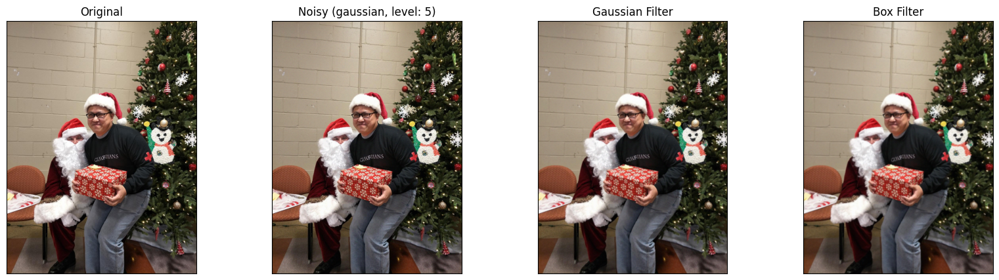

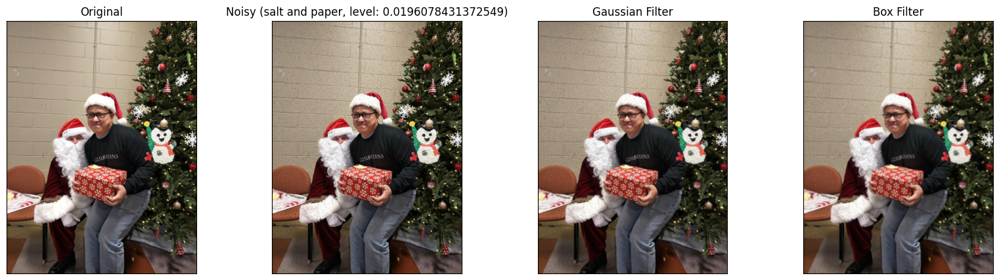

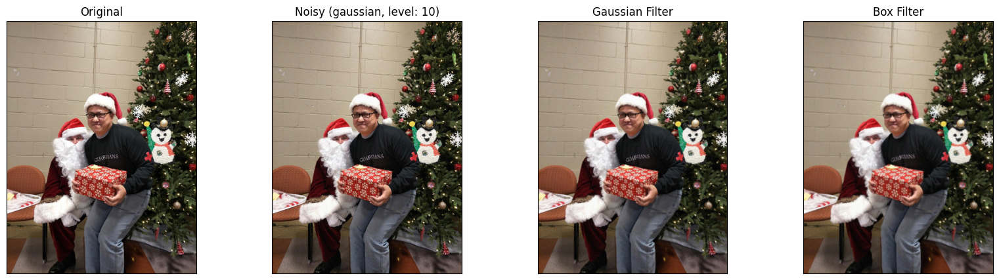

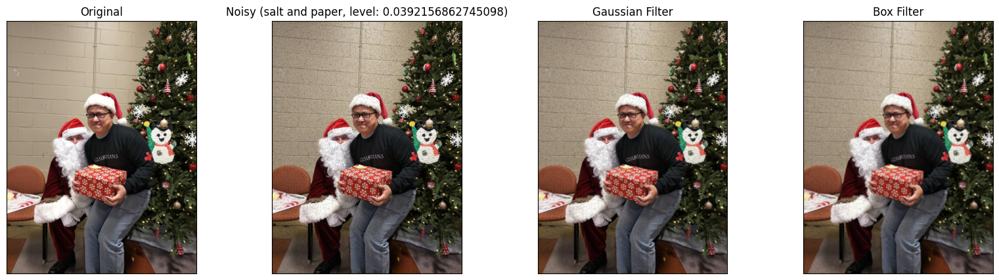

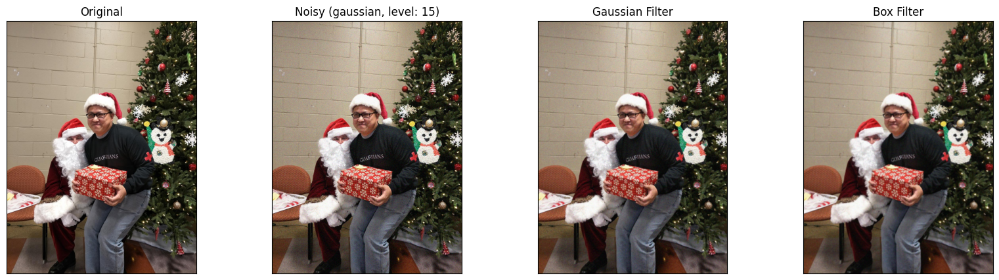

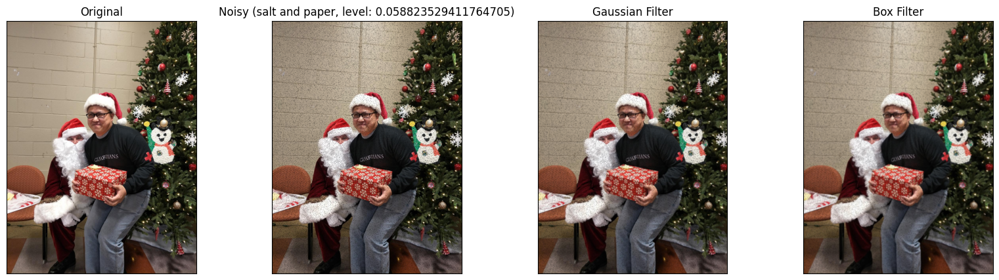

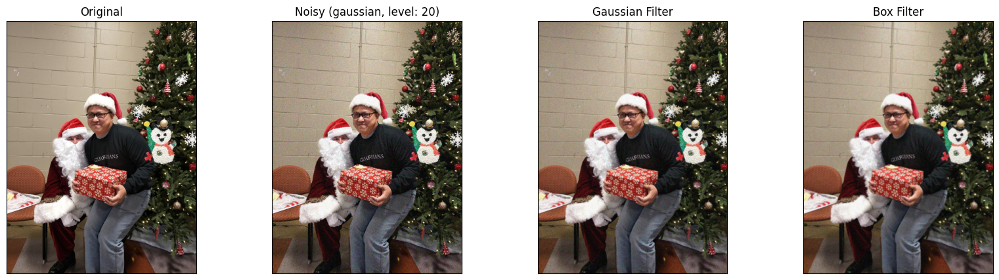

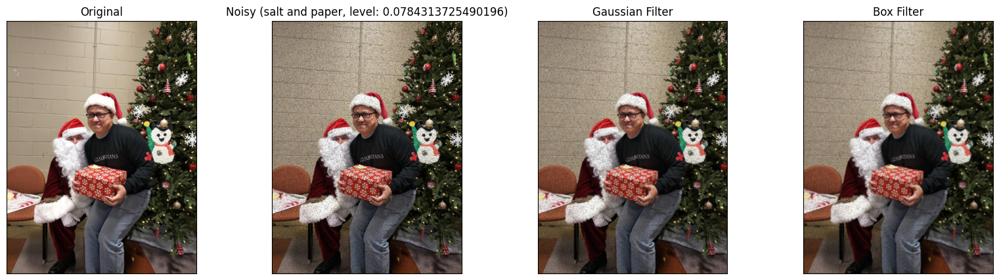

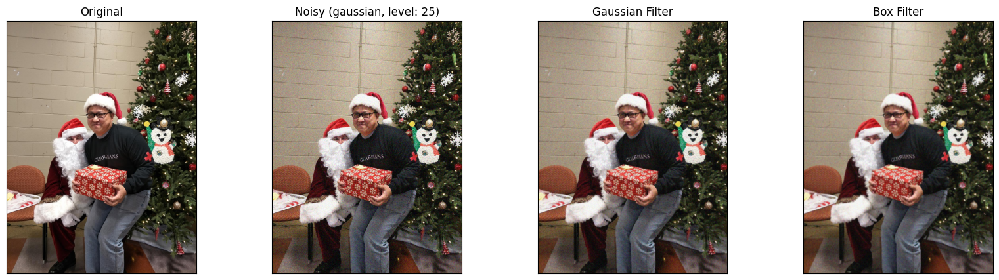

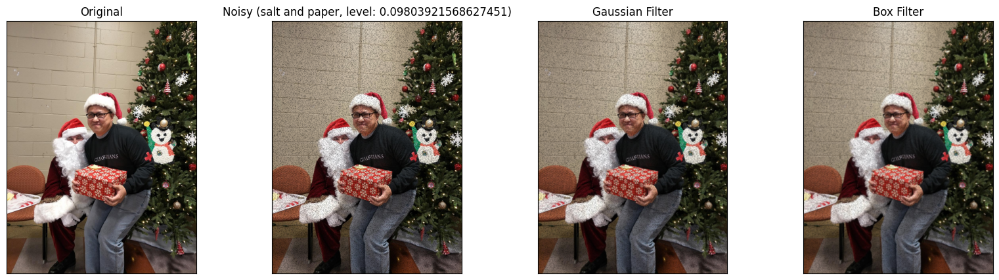

In [34]:
# Implement Task 3.2here.


def applyGaussianFilter(img, kernel_size=5):
    return cv.GaussianBlur(img, (kernel_size, kernel_size), 0)

def applyBoxFilter(img, kernel_size=5):
    return cv.blur(img, (kernel_size, kernel_size))

def showImages(img, noise_type, noise_level, kernel_size=5):
    if noise_type == 'gaussian': # gaussian noise
        noisy_img = addGaussianNoise(img, noise_level)
    if noise_type == 'salt and paper': # salt noise
        noisy_img = addSaltAndPepperNoise(img, noise_level)

    filtered_img_gaussian = applyGaussianFilter(noisy_img, kernel_size)
    filtered_img_box = applyBoxFilter(noisy_img, kernel_size)

    titles = ['Original', f'Noisy ({noise_type}, level: {noise_level})', 'Gaussian Filter', 'Box Filter']
    images = [img, noisy_img, filtered_img_gaussian, filtered_img_box]

    plt.figure(figsize=(20, 5))
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.xticks([]), plt.yticks([])
    plt.show()



url = "https://media.licdn.com/dms/image/C4D2DAQEMosc8jtR0vw/profile-treasury-image-shrink_1280_1280/0/1618509105583?e=1707307200&v=beta&t=akcVurKLDJx6hAio6TDCYvPzfbYXdEdFVrChHqrgosQ"
img = io.imread(url)
noise_levels = [5, 10, 15, 20, 25]
for noise_level in noise_levels:
    showImages(img, 'gaussian', noise_level)
    showImages(img, 'salt and paper', noise_level / 255.0)


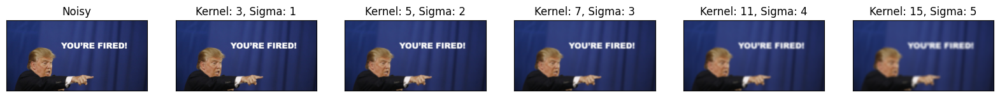

In [36]:
# Implement Task 3.3 here.

def applyGaussianFilter(img, kernel_size, sigma):
    return cv.GaussianBlur(img, (kernel_size, kernel_size), sigma)

def showImagesWithDifferentGaussianFilters(noisy_img, kernel_sizes, sigmas):
    plt.figure(figsize=(20, 5))
    plt.subplot(1, len(kernel_sizes) + 1, 1)
    plt.imshow(noisy_img, cmap='gray')
    plt.title('Noisy')
    plt.xticks([]), plt.yticks([])

    for i, (kernel_size, sigma) in enumerate(zip(kernel_sizes, sigmas), start=2):
        filtered_img = applyGaussianFilter(noisy_img, kernel_size, sigma)
        plt.subplot(1, len(kernel_sizes) + 1, i)
        plt.imshow(filtered_img, cmap='gray')
        plt.title(f'Kernel: {kernel_size}, Sigma: {sigma}')
        plt.xticks([]), plt.yticks([])

    plt.show()



url = "https://www.lampadia.com/assets/uploads_images/images/4%2819%29.jpg"
img = io.imread(url)
kernel_sizes = [3, 5, 7, 11, 15]
sigmas = [1, 2, 3, 4, 5]
showImagesWithDifferentGaussianFilters(img, kernel_sizes, sigmas)

## Exercse 4: Implementing convolution from scratch

Image filtering (or convolution) is a fundamental image processing tool. In this exercise, you will be writing your own function to implement image filtering from scratch. More specifically, you will implement the function `my_filter2D()` which imitates the filter2D function in the OpenCV library.

Your filtering algorithm must
- (1) support grayscale and color images
- (2) support arbitrary shaped filters, as long as both dimensions are odd (e.g. 7x9 filters but not 4x5 filters)
- (3) pad the input image with zeros or reflected image content and
- (4) return a filtered image which is the same resolution as the input image.

In [69]:
# Use this cell to implement Exercise 4. Use additional cells if necessary.
def my_filter2D(image, kernel, padding_type='zero'):
    # Check if kernel dimensions are odd
    if kernel.shape[0] % 2 == 0 or kernel.shape[1] % 2 == 0:
        raise ValueError("Kernel dimensions must be odd")

    # Image dimensions and padding size
    img_height, img_width = image.shape[:2]
    pad_height, pad_width = kernel.shape[0] // 2, kernel.shape[1] // 2

    # Padding
    if padding_type == 'zero':
        padded_img = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='constant')
    elif padding_type == 'reflect':
        padded_img = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='reflect')
    else:
        raise ValueError("Unsupported padding type")

    # Filtered image
    filtered_img = np.zeros_like(image)

    # Convolution operation
    for i in range(img_height):
        for j in range(img_width):
            for k in range(image.shape[2]): # For each color channel
                region = padded_img[i:i+kernel.shape[0], j:j+kernel.shape[1], k]
                filtered_img[i, j, k] = np.sum(region * kernel)

    return filtered_img




## Exercse 5: Test your implementation
Demonstrate the correctness of your my_filter2D function implementation from Exercise 4, by applying it to different scenarios. Compare the output of your function to the corresponding output from when using cv.imfilter2D method provided by openCV library (i.e. show the two results side by side). In particular demonstrate the your implementation supports:

  - support grayscale and color images
  - support arbitrary shaped filters,
  - supports pad the input image with zeros or reflected image content




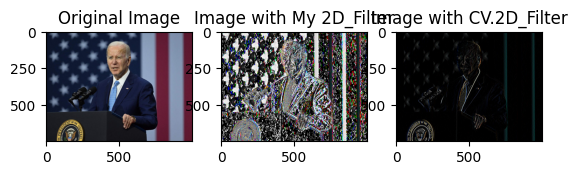

In [70]:
url = "https://i.insider.com/63fe6b4a59a49100187da117?width=1000&format=jpeg&auto=webp"
img = io.imread(url)

kernel = np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]]) # Example kernel
filtered_img = my_filter2D(img, kernel, 'reflect')
cv_2dimg = cv.filter2D(img, -1, kernel)

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img)

plt.subplot(1, 3, 2)
plt.title("Image with My 2D_Filter")
plt.imshow(filtered_img)

plt.subplot(1, 3, 3)
plt.title("Image with CV.2D_Filter")
plt.imshow(cv_2dimg)

plt.show()


Copyright Statement: Copyright © 2020 Christoforou. The materials provided by the instructor of this course, including this notebook, are for the use of the students enrolled in the course. Materials are presented in an educational context for personal use and study and should not be shared, distributed, disseminated or sold in print — or digitally — outside the course without permission. You may not, nor may you knowingly allow others to reproduce or distribute lecture notes, course materials as well as any of their derivatives without the instructor's express written consent.